In [2]:
import duckdb
import requests
import pandas as pd
import os

import json
import geopandas as gpd
import folium

In [3]:
## General Bikeshare Feed Specification Standard
# gbfs = requests.get('https://gbfs.mex.lyftbikes.com/gbfs/gbfs.json').json()
gbfs = requests.get('https://gbfs.mex.lyftbikes.com/gbfs/en/station_information.json').json()

## Get the Stations Information
# stations_url =  gbfs['data']['es']['feeds'][0]['url']
stations_list =  gbfs['data']['stations']

In [5]:
stations_t = pd.DataFrame(stations_list)

In [11]:
stations_zips = pd.read_csv('/Volumes/T7 Shield/Ecobici/stations_alcaldias_colonias_zips.csv').rename(columns={'ciclo_estacionarribo':'short_name'})

In [14]:
fileFolder = '/Volumes/T7 Shield/Ecobici/CLEAN'

rides_24 = duckdb.sql(f""" 
    SELECT * EXCLUDE(fecha_retiro,fecha_arribo),fecha_retiro_completa::date AS fecha_retiro,fecha_arribo_completa::date AS fecha_arribo   
    FROM read_parquet([
    '{fileFolder}/2025/*.parquet',
    '{fileFolder}/2024/*.parquet'
]) 
""")

In [15]:
stations_and_trips = duckdb.sql(f"""SELECT
    fecha_arribo_completa,
           ciclo_estacion_retiro, ciclo_estacionarribo,
           lat_start,lon_start,
           lat_end,lon_end,
           sl1.name  as start_station,
           sl2.name as end_station,
           ROUND(distance_meters::NUMERIC,2) as distance_meters,
           ROUND(time_between_trips::NUMERIC,2) as time_between_trips
FROM rides_24
LEFT JOIN stations_t as sl1 ON ciclo_estacion_retiro = sl1.short_name
LEFT JOIN stations_t as sl2 ON ciclo_estacionarribo = sl2.short_name
""")


In [16]:
stations = duckdb.sql("""SELECT ciclo_estacionarribo,date_trunc('month' ,fecha_arribo_completa)::DATE::STRING as fecha_arribo_completa, end_station, lat_end, lon_end, 
    COUNT(*) as total_trips
    FROM stations_and_trips
    WHERE end_station IS NOT NULL
    GROUP BY 1,2,3,4,5
    ORDER BY fecha_arribo_completa DESC, total_trips DESC
""").df()


In [244]:
stations.query('end_station == "CE-335 Magdalena-Ameyalco"')
     

,ciclo_estacionarribo,fecha_arribo_completa,end_station,lat_end,lon_end,total_trips
493,335,2025-01-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1470
1146,335,2024-12-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1433
1812,335,2024-11-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1724
2490,335,2024-10-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1831
3182,335,2024-09-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1596
3846,335,2024-08-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1668
4542,335,2024-07-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1519
5197,335,2024-06-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1686
5861,335,2024-05-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,882
6544,335,2024-04-01,CE-335 Magdalena-Ameyalco,19.386989,-99.173438,1696


In [130]:
# Convert DataFrame to GeoJSON format
geojson_trips = {
    "type": "FeatureCollection",
    "features": []
}

# Create a feature for each station
for _, row in stations.iterrows():
    feature = {
        "type": "Feature",
        "properties": {
            "ciclo_estacionarribo": row['ciclo_estacionarribo'],
            "total_trips": row['total_trips'],
            "date": row['fecha_arribo_completa']
        },
        "geometry": {
            "type": "Point",
            "coordinates": [row['lon_end'], row['lat_end']]
        }
    }
    geojson_trips['features'].append(feature)


In [134]:
geojson_trips

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'ciclo_estacionarribo': '271-272',
    'total_trips': 21627,
    'date': '2025-01-01'},
   'geometry': {'type': 'Point', 'coordinates': [-99.152465, 19.443684]}},
  {'type': 'Feature',
   'properties': {'ciclo_estacionarribo': '548',
    'total_trips': 13746,
    'date': '2025-01-01'},
   'geometry': {'type': 'Point',
    'coordinates': [-99.15431119504319, 19.447028903088047]}},
  {'type': 'Feature',
   'properties': {'ciclo_estacionarribo': '014',
    'total_trips': 13584,
    'date': '2025-01-01'},
   'geometry': {'type': 'Point', 'coordinates': [-99.173247, 19.42454]}},
  {'type': 'Feature',
   'properties': {'ciclo_estacionarribo': '107-108',
    'total_trips': 11033,
    'date': '2025-01-01'},
   'geometry': {'type': 'Point', 'coordinates': [-99.149533, 19.427305]}},
  {'type': 'Feature',
   'properties': {'ciclo_estacionarribo': '064',
    'total_trips': 10433,
    'date': '2025-01-01'},
   'geomet

In [132]:
with open(os.path.join(fileFolder, '/Volumes/T7 Shield/Ecobici/ecobici_trips.geojson'), 'w') as f:
	json.dump(geojson_trips, f)

In [133]:
with duckdb.connect('/Users/gerardomartinez/Documents/ecobici_project/ecobici/evidence_project/sources/ecobici5/routes6.duckdb') as con:
    con.execute(f"""
    DROP TABLE IF EXISTS example_stations
    """)
    
    con.execute(f"""
        CREATE TABLE example_stations AS 
        SELECT * FROM stations""")

In [83]:
with open('/Volumes/T7 Shield/Ecobici/limite-de-las-alcaldas.json') as f:
    alcaldias = json.load(f)


In [110]:
with open('/Users/gerardomartinez/Documents/ecobici_project/ecobici/backend/examplify.json') as f:
    groo = json.load(f)


In [218]:
with open('/Volumes/T7 Shield/Ecobici/georef-mexico-colonia@public.geojson') as f:
    colonias = json.load(f)


In [239]:
pd.concat([pd.DataFrame([{
        'col_name': cols['properties']['col_name'][0],
        'mun_name': cols['properties']['mun_name'][0]
    }]) for cols in colonias['features']]
   ).drop_duplicates().reset_index(drop=True)

,col_name,mun_name
0,Manuel Rivera Anaya Croc I (U Hab),Azcapotzalco
1,San Alvaro,Azcapotzalco
2,San Andres (Barr),Azcapotzalco
3,San Salvador Xochimanca,Azcapotzalco
4,Santa Cruz De Las Salinas,Azcapotzalco
...,...,...
1829,Nueva Generacion 103,Iztapalapa
1830,El Toro,La Magdalena Contreras
1831,Independencia San Ramon (U Hab),La Magdalena Contreras
1832,Arcos De Centenario,Álvaro Obregón


In [243]:
# Create a base map centered on Mexico City
m = folium.Map(location=[19.4326, -99.1332], zoom_start=11)

# for idx, row in alcaldias_gdf.iterrows():
#     folium.GeoJson(data=row.geometry,
#                    tooltip=row['NOMGEO'],
#                    style_function=lambda x: {
#                        'fillColor': '#ADD8E6',  # Light blue
#                        'color': 'black',
#                        'weight': 1,
#                        'fillOpacity': 0.3
#                    }).add_to(m)

# Add the alcaldias boundaries with different colors and a legend
for feature in colonias['features']:
    folium.GeoJson(
        data=feature,
        style_function=lambda x: {
            'fillColor': '#ffcb69',  # Light orange
            'color': 'gray',
            'weight': 1,
            'fillOpacity': 0.1
        },
        tooltip=feature['properties'].get('col_name', 'N/A')
    ).add_to(m)

for _, row in stations.iterrows():
    folium.CircleMarker(
        location=[row['lat_end'], row['lon_end']],
        radius=5,
        popup=f"{row['end_station']}<br>Total trips: {row['total_trips']}",
        color='red',
        fill=True,
        fillOpacity=0.7
    ).add_to(m)



m

In [112]:
# Convert the GeoJSON to a GeoDataFrame CE-335 Magdalena-Ameyalco
alcaldias_gdf = gpd.GeoDataFrame.from_features(alcaldias['features'])

In [113]:
data = alcaldias_gdf.iloc[0:1,:]

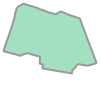

In [114]:
data['geometry'][0]

In [94]:
# Create a base map centered on Mexico City
m = folium.Map(location=[19.4326, -99.1332], zoom_start=11)

# Add the alcaldias boundaries with different colors and a legend
for idx, row in alcaldias_gdf.iterrows():
    folium.GeoJson(data=row.geometry,
                   tooltip=row['NOMGEO'],
                   style_function=lambda x: {
                       'fillColor': '#ADD8E6',  # Light blue
                       'color': 'black',
                       'weight': 1,
                       'fillOpacity': 0.3
                   }).add_to(m)

# Add stations as markers using the data from stations DataFrame
for _, row in stations.iterrows():
    folium.CircleMarker(
        location=[row['lat_end'], row['lon_end']],
        radius=5,
        popup=f"{row['end_station']}<br>Total trips: {row['total_trips']}",
        color='red',
        fill=True,
        fillOpacity=0.7
    ).add_to(m)

m

In [93]:
# Create a base map centered on Mexico City
m = folium.Map(location=[19.4326, -99.1332], zoom_start=11)

# Add the alcaldias boundaries with different colors and a legend
for idx, row in alcaldias_gdf.iterrows():
    # Convert geometry to lat/lon pairs
    folium.GeoJson(data=row.geometry,
                   tooltip=row['NOMGEO'],
                   style_function=lambda x: {
                       'fillColor': '#ADD8E6',  # Light blue
                       'color': 'black',
                       'weight': 1,
                       'fillOpacity': 0.3
                   }).add_to(m)

# Add stations as markers
for station in geojson_trips['features']:
    folium.CircleMarker(
        location=[station.lat, station.lon],
        radius=3,
        color='red',
        fill=True,
        popup=station.name
    ).add_to(m)

AttributeError: 'dict' object has no attribute 'lat'

In [89]:
# Create a base map centered on Mexico City
m = folium.Map(location=[19.4326, -99.1332], zoom_start=11)

# Add the alcaldias boundaries with different colors and a legend
for idx, row in alcaldias_gdf.iterrows():
    # Convert geometry to lat/lon pairs
    folium.GeoJson(data=row.geometry,
                   tooltip=row['NOMGEO'],
                   style_function=lambda x: {
                       'fillColor': '#ADD8E6',  # Light blue
                       'color': 'black',
                       'weight': 1,
                       'fillOpacity': 0.3
                   }).add_to(m)

# Add stations as markers
for _, station in geojson_trips.iterrows():
    folium.CircleMarker(
        location=[station.lat, station.lon],
        radius=3,
        color='red',
        fill=True,
        popup=station.name
    ).add_to(m)

m

AttributeError: 'dict' object has no attribute 'iterrows'